In [1]:
import scanpy as sc
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('TkAgg')
%matplotlib inline

In [2]:
sc.settings.verbosity = 0  
sc.settings.set_figure_params(dpi=600, dpi_save=600, fontsize=14, facecolor='white', format='tiff')
sc.settings.n_jobs = 10

wd = '/home/davi/Bioinfo/Lucas/'

In [3]:
# Load data
adata = sc.read_h5ad(wd + 'Hyp_integration.h5ad')
adata

AnnData object with n_obs × n_vars = 51623 × 31376
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'Age', 'Class', 'ClassProbability_Astrocyte', 'ClassProbability_Astrocyte.Immune', 'ClassProbability_Astrocyte.Neurons', 'ClassProbability_Astrocyte.Oligos', 'ClassProbability_Astrocyte.Vascular', 'ClassProbability_Bergmann.glia', 'ClassProbability_Blood', 'ClassProbability_Blood.Vascular', 'ClassProbability_Enteric.glia', 'ClassProbability_Enteric.glia.Cycling', 'ClassProbability_Ependymal', 'ClassProbability_Ex.Neurons', 'ClassProbability_Ex.Vascular', 'ClassProbability_Immune', 'ClassProbability_Immune.Neurons', 'ClassProbability_Immune.Oligos', 'ClassProbability_Neurons', 'ClassProbability_Neurons.Cycling', 'ClassProbability_Neurons.Oligos', 'ClassProbability_Neurons.Satellite.glia', 'ClassProbability_Neurons.Vascular', 'ClassProbability_OEC', 'ClassProbability_Oligos', 'ClassProbability_Oligos.Cycling', 'ClassProbability_Oligos.Vascular', 'ClassProbability_Satellit

In [4]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,Age,Class,ClassProbability_Astrocyte,ClassProbability_Astrocyte.Immune,ClassProbability_Astrocyte.Neurons,ClassProbability_Astrocyte.Oligos,...,X_Total,X_Valid,X_X,X_Y,Study,nCount_SCT,nFeature_SCT,integrated_snn_res.0.8,seurat_clusters,Celltype
B0CCCCGGGCTTGT_Normal_1,SeuratProject,13088.0,4637,0.000000,NA,NA,NaN,NaN,NaN,NaN,...,NaN,-2147483648,NaN,NaN,Chen,2571.0,1645,15,15,Astrocytes-Tanycytes
B0ATTGGAATGGCC_Normal_1,SeuratProject,11285.0,4014,0.000000,NA,NA,NaN,NaN,NaN,NaN,...,NaN,-2147483648,NaN,NaN,Chen,2529.0,1671,4,4,Neurons
B0TTCCAACCGAAG_Normal_1,SeuratProject,10119.0,3775,0.000000,NA,NA,NaN,NaN,NaN,NaN,...,NaN,-2147483648,NaN,NaN,Chen,2484.0,1619,0,0,Neurons
B0AGCAGGCGTAAN_Normal_1,SeuratProject,7159.0,3246,0.000000,NA,NA,NaN,NaN,NaN,NaN,...,NaN,-2147483648,NaN,NaN,Chen,2578.0,1764,0,0,Neurons
B0TACGGTTCTACN_Normal_1,SeuratProject,7098.0,3189,0.000000,NA,NA,NaN,NaN,NaN,NaN,...,NaN,-2147483648,NaN,NaN,Chen,2868.0,1851,14,14,Astrocytes-Tanycytes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X57_1_AGAGACCGGGAA-_4,10X57,7442.0,2953,2.674012,p25-27,Neurons,0.000014,0.000012,0.002074,0.000009,...,7442.0,1,-30.773705,13.238083,Zeisel,1764.0,1103,1,1,Neurons
10X35_4_AGACCTGTCATG-_4,10X35,3120.0,1781,2.275641,p26,Neurons,0.000005,0.000006,0.000708,0.000006,...,3120.0,1,-30.806486,13.768654,Zeisel,2239.0,1689,5,5,Neurons
10X51_4_GTAAACAAACGA-_4,10X51,1543.0,819,4.147764,p19,Neurons,0.000005,0.000006,0.000274,0.000003,...,1543.0,1,-30.824899,13.786436,Zeisel,1568.0,819,0,0,Neurons
10X51_4_GCATTGGCGAAG-_4,10X51,6746.0,2355,2.564483,p19,Neurons,0.000018,0.000014,0.001441,0.000012,...,6746.0,1,-30.727260,12.717716,Zeisel,1938.0,1212,1,1,Neurons


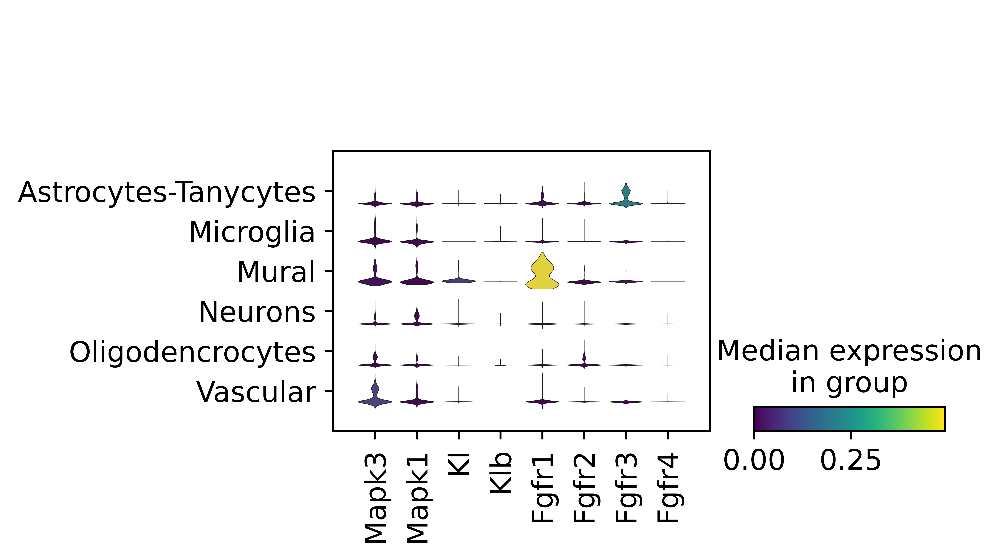

In [7]:
# ERK1 ERK2 KLOTO A-KLOTO B-KLOTO FGFR1 FGFR2 FGFR3 FGFR4
gene_list = ['Mapk3', 'Mapk1', 'Kl', 'Klb', 'Fgfr1', 'Fgfr2', 'Fgfr3', 'Fgfr4']
sc.pl.stacked_violin(adata, gene_list, groupby='Celltype', vmin=0, log=False, cmap='plasma', save='Violin')

In [15]:
adata.obs['Cell type'] = adata.obs['Celltype']
adata.obsm['X_dbMAP'] = adata.obsm['X_dbmap']

# Rename column names
adata.obs['Study'] = adata.obs['Study'].str.replace('Yoo-lep', 'Yoo')
adata.obs['Study'] = adata.obs['Study'].str.replace('Yoo-saline', 'Yoo')

/home/davi/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


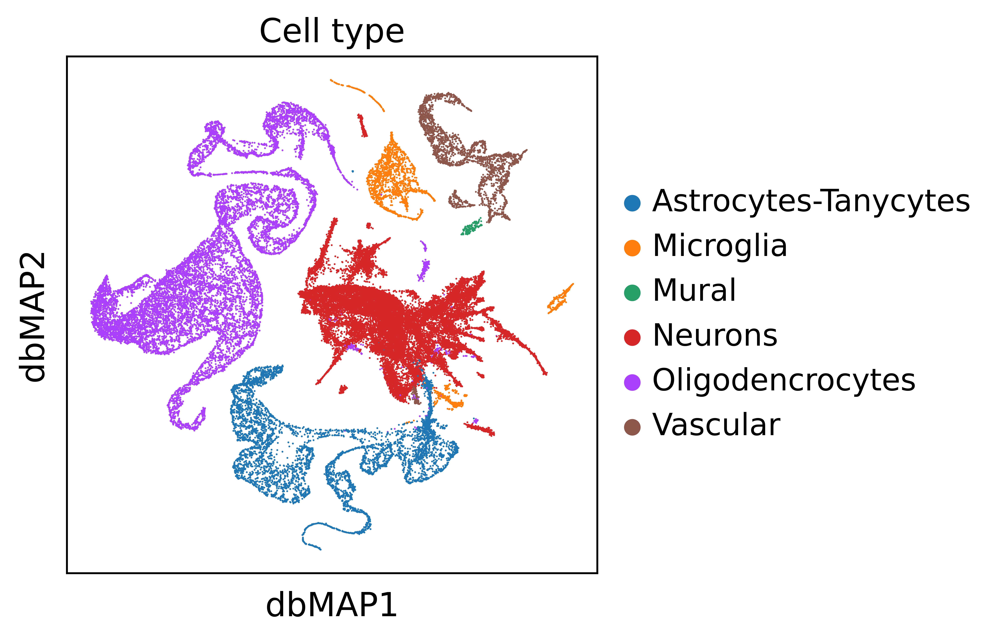

In [12]:
sc.pl.embedding(adata, basis='dbMAP', color='Cell type', save='Celltype')

In [23]:
# Rename column names
adata.obs['Study'] = adata.obs['Study'].str.replace('Yoo', 'Yoo et al.')
adata.obs['Study'] = adata.obs['Study'].str.replace('Chen', 'Chen et al.')
adata.obs['Study'] = adata.obs['Study'].str.replace('Zeisel', 'Zeisel et al.')

/home/davi/.local/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


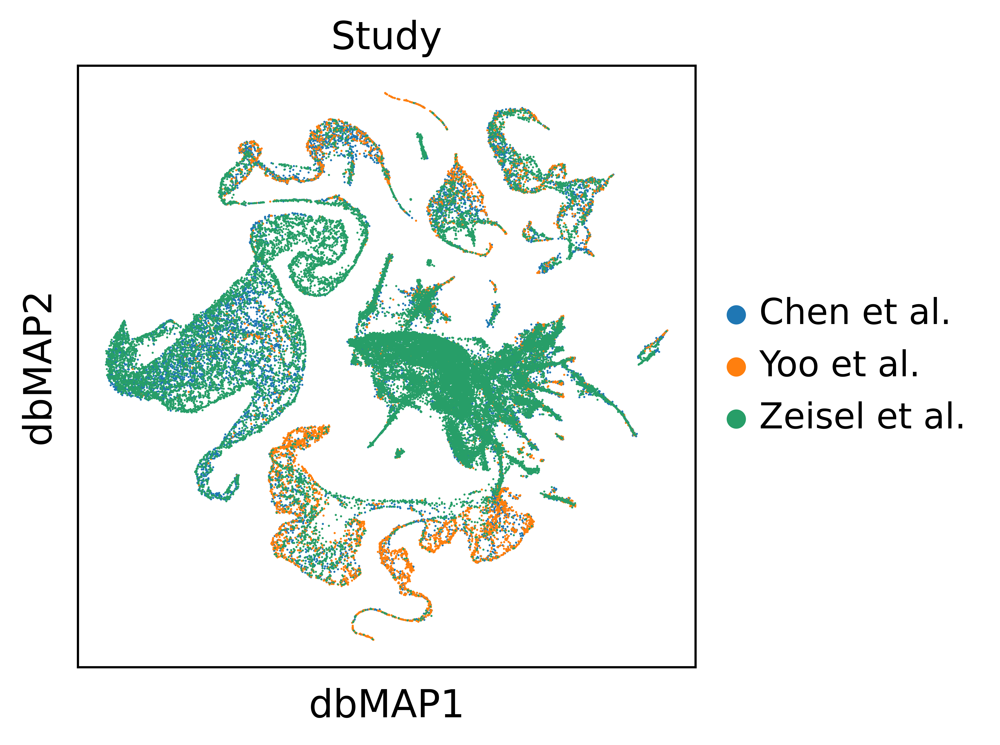

In [24]:
sc.pl.embedding(adata, basis='dbMAP', color='Study', save='Study')

In [22]:
sc.pl.embedding(adata, basis='dbMAP', color=['Fgfr1', 'Fgfr2', 'Fgfr3', 'Fgfr4'], vmin=0, vmax=[1, 1, 1, 0.5], cmap='plasma', save='genes', ncols=3)